# Summary

Using the fruad transactional data from the IEEE Computational Intelligence Society (IEEE-CIS). We do simple Exploratory Data Analysis and use pandas profiling on only a fraction of the dataset. Thereafter what seems to be factors from dimensional reduction techniques we are interested in find out which of these features are most significant we perform a LOFO. The idea would be to serve a model as an api but only using the most significant predictors. We build a logistic regression using Scikit-learn and and a catboost model to predict fraudulent transactions.

# Import Libraries 

In [150]:
import pandas as pd
import numpy as np
import pandas_profiling
from sklearn.preprocessing import scale
from sklearn.model_selection import KFold
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report,accuracy_score
from lofo import LOFOImportance, Dataset, plot_importance
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import pickle
from sklearn.externals import joblib
%matplotlib inline

pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 100)

# Reading in Data

In [96]:
data =  pd.read_csv("train_transaction.csv")
data2 = pd.read_csv("train_identity.csv")
data_test =  pd.read_csv("test_transaction.csv")
data2_test = pd.read_csv("test_identity.csv")

# Simple EDA 

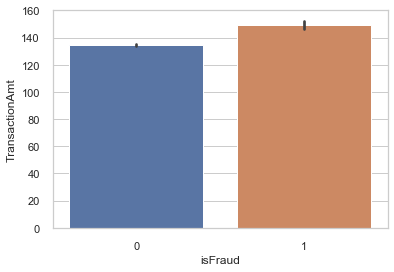

In [3]:
sns.set(style="whitegrid")
ax = sns.barplot(x="isFraud",y="TransactionAmt", data=data)

In [70]:
data.isFraud.value_counts()

0    569877
1     20663
Name: isFraud, dtype: int64

In [97]:
final= pd.merge(data,data2, on=["TransactionID"])
final_test= pd.merge(data_test, data2_test, on=["TransactionID"])

In [126]:
#final.dtypes

In [99]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
drop = final.isnull().sum()
#np.round(final[i].isnull().sum()/final.shape[0]*100,2)

In [100]:
drop = pd.DataFrame(data=drop, columns=['NaN values'])
drop['perc of NaN values'] = drop['NaN values'].apply(lambda x: np.round(x/final.shape[0]*100,2))
#We can drop these columns without much investigation becuase we don't know the meaning of the variable
drop['drop'] = np.where(drop['perc of NaN values']>50, 'yes', 'no')

In [101]:
drop['drop'].value_counts()

no     305
yes    129
Name: drop, dtype: int64

In [102]:
column_names = drop[drop['drop']=='yes'].index.tolist()
final.drop(column_names, axis=1, inplace=True)
final_test.drop(column_names, axis=1, inplace=True)

In [103]:
#Imputation for numerical values for both train and test 
for col in final.columns:
    if final[col].dtypes=='int64' or final[col].dtypes=='float64':
        final[col].fillna(final[col].mean(), inplace=True)
        
for col in final_test.columns:
    if final_test[col].dtypes=='int64' or final_test[col].dtypes=='float64':
        final_test[col].fillna(final_test[col].mean(), inplace=True)        

In [104]:
for col in final.columns:
    if final[col].dtypes=='object':
        final[col].fillna(final[col].mode()[0], inplace=True)

for col in final_test.columns:
    if final_test[col].dtypes=='object':
        final_test[col].fillna(final_test[col].mode()[0], inplace=True)        

In [105]:
#final.dtypes
final.dropna(axis=0, how='all',inplace=True)

In [106]:
#final.isnull().sum()
final[final.isnull()]

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D8,D9,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [88]:
"""
for i in final.columns:
    print(i,"NaN values:", final[i].isnull().sum())
    print("type is:", final[i].dtypes,end=" ")
    print("% of NaN values:",np.round(final[i].isnull().sum()/final.shape[0]*100,2))

"""


'\nfor i in final.columns:\n    print(i,"NaN values:", final[i].isnull().sum())\n    print("type is:", final[i].dtypes,end=" ")\n    print("% of NaN values:",np.round(final[i].isnull().sum()/final.shape[0]*100,2))\n\n'

In [107]:
sample_df = final.sample(frac=0.1, random_state=111)

In [108]:
pandas_profiling.ProfileReport(sample_df)

# Variable Importance

In [109]:
cv = KFold(n_splits =3, shuffle=False, random_state =111)

In [110]:
target = "isFraud"
features = [col for col in sample_df.columns if col != target]

In [111]:
dataset = Dataset(df=sample_df, target=target, features= features)

In [112]:
lofo = LOFOImportance(dataset, cv=cv, scoring="roc_auc")

In [113]:
importance_df = lofo.get_importance()

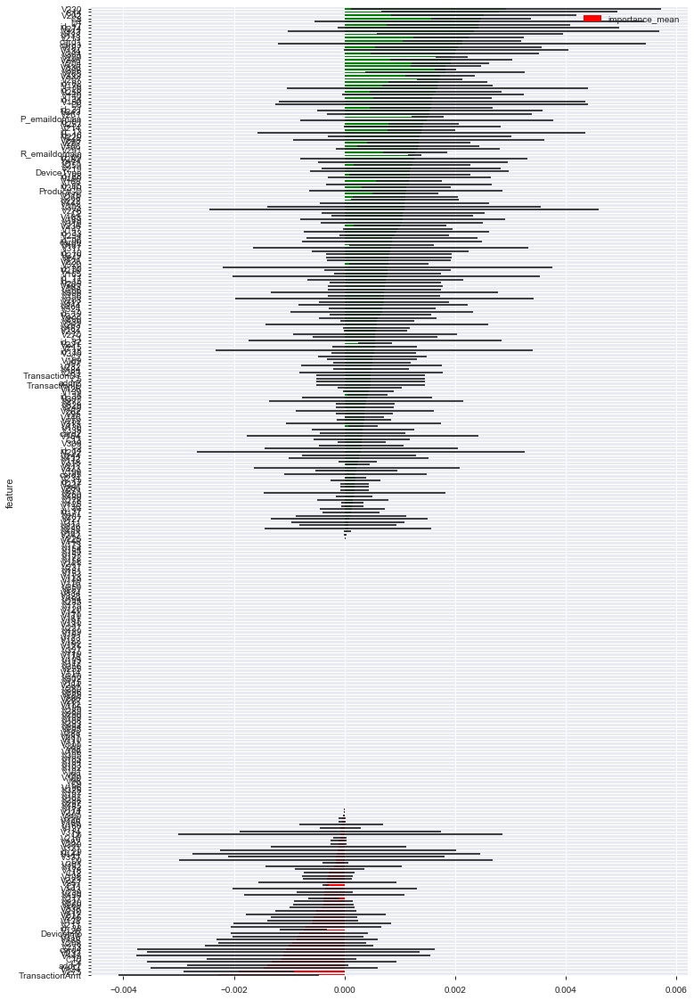

In [114]:
plot_importance(importance_df, figsize=(12,20))

In [72]:
#!pip install catboost

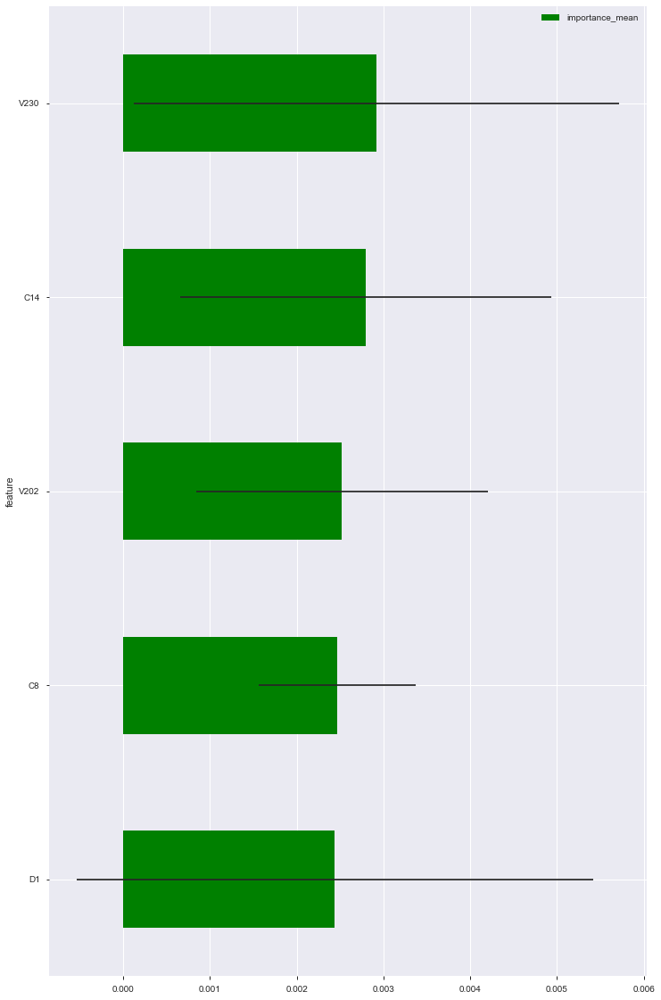

In [141]:
#Top 5 features
plot_importance(importance_df[:5], figsize=(12,20))

# Modeling 

In [128]:
# Importing LabelEncoder and initializing it

le=LabelEncoder()
# Iterating over all the common columns in train and test
for col in final.columns.values:
    
       # Encoding only categorical variables
    if final[col].dtypes=='object':
           # Using whole data to form an exhaustive list of levels
        data = final[col].append(final_test[col])
        le.fit(data.values)
        final[col]=le.transform(final[col])
        final_test[col]=le.transform(final_test[col])

In [130]:
final.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D8,D9,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987004,0,86506,50.000,1,4497,514.0,150.0,2,102.0,1,420.000000,87.000000,16,16,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,146.058108,0.561057,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,6.00000,18.000000,140.000000,0.000000,0.000000,0.000000,0.000000,1803.00000,49.000000,64.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15557.990234,169690.796875,0.000000,0.000000,0.00000,515.000000,5155.000000,2840.00000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,70787.0,1.615585,-6.69871,0.091023,-0.301124,100.0,1,48.053071,-480.000000,1,1,166.0,542.0,144.0,1,1,7,161,32.000000,268,3,1,0,1,1,1,1565
1,2987008,0,86535,15.000,1,2803,100.0,150.0,3,226.0,2,337.000000,87.000000,1,16,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,146.058108,0.561057,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,6.00000,18.000000,140.000000,0.000000,0.000000,0.000000,0.000000,1804.00000,49.000000,64.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15607.990234,169740.796875,0.000000,0.000000,0.00000,515.000000,5155.000000,2840.00000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

In [131]:
final['isFraud'].values

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [132]:
final_test.head()

,TransactionID,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D8,D9,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,3663586,18404013,6.271,0,15885,545.0,185.0,3,138.0,2,299.042252,86.121134,19,19,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,35.960366,160.834483,0.553981,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.038345,1.043198,1.126102,0.043647,0.062793,1.781193,2.812103,17.120675,0.141559,0.162914,0.754142,0.760542,135.252945,5.44714,8.338876,0.748536,0.752952,0.756099,0.762763,0.801068,0.814278,6216.751417,98170.082905,4.988264,8.259853,6.140613,1039.076257,5451.513734,1388.883013,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,0.000,0.000,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000,0.000,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,0.000,0.000,0.0,0.0,0.147181,1.243995,1.388985,0.0,0.0,0.0,0.0,0.148695,0.174048,1.0,1.0,1.0,0.0,0.0,0.0,0.291032,0.0,0.0,0.0,0.094817,0.102646,1.0,1.0,1.0,1.0,0.000,0.000,0.000,0.0,0.0,0.0,0.0,7.869501,14.17575,9.371612,0.0,0.0,0.0,0.000,0.000,0.000,0.436708,1.216787,0.693784,0.047907,0.482609,0.163256,0.220497,0.461002,0.310044,315.35668,440.826274,381.380525,24.697658,58.348326,35.482716,98.976834,155.540674,139.745753,-45.0,280290.0,0.0,0.0,0.076219,-0.245877,100.0,1,27.000000,-344.482672,1,1,225.0,427.0,563.0,1,1,49,62,26.217939,216,3,0,0,1,0,1,1168
1,3663588,18404055,50.000,3,2453,399.0,150.0,0,137.0,1,494.000000,87.000000,16,16,4.0,8.0,0.0,4.0,0.0,0.0,0.0,25.0,0.0,30.0,5.0,0.0,57.0,4.0,34.000000,22.000000,0.000000,0.0,7.0,2.0,0.0,7.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,1.0,0.0,280.0,90.0,0.0,280.0,90.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.00000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,280.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000,40.000,0.000,0.0,0.0

In [133]:
cols = [col for col in final.columns if col != "isFraud"]
X = final[cols]
y = final['isFraud']
train_x, validation_x, train_y ,validation_y = train_test_split(X, y, stratify =y, random_state =111, test_size =0.2)
#categorical_features_indices = np.where(train_x.dtypes !=np.float)
#categorical_features_indices[0]

In [134]:
from sklearn.preprocessing import scale
# Standardizing the features
X_train_scale=scale(train_x)
X_test_scale=scale(validation_x)
# Fitting the logistic regression model
log=LogisticRegression(penalty='l2',C=.01)
log.fit(X_train_scale,train_y)
# Checking the models accuracy
accuracy_score(validation_y,log.predict(X_test_scale))

0.9471002183935938

In [159]:
type(validation_x)

pandas.core.frame.DataFrame

In [138]:
# save the model to disk
filename = 'logistic_all_variables.sav'
pickle.dump(log, open(filename, 'wb'))

In [139]:
# load the model from disk
loaded_model = pickle.load(open(filename, 'rb'))
#result = loaded_model.score(X_test, Y_test)
#print(result)

print(accuracy_score(validation_y,loaded_model.predict(X_test_scale)))

0.9471002183935938


In [137]:
# Save the model as a pickle in a file
joblib.dump(log, 'logistic_all_variables.pkl') 

['logistic_all_variables.pkl']

In [ ]:
# Use the loaded model to make predictions
clf_from_joblib.predict(X)

In [142]:
final.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D8,D9,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,id_01,id_02,id_05,id_06,id_09,id_10,id_11,id_12,id_13,id_14,id_15,id_16,id_17,id_19,id_20,id_28,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987004,0,86506,50.000,1,4497,514.0,150.0,2,102.0,1,420.000000,87.000000,16,16,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,146.058108,0.561057,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,6.00000,18.000000,140.000000,0.000000,0.000000,0.000000,0.000000,1803.00000,49.000000,64.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15557.990234,169690.796875,0.000000,0.000000,0.00000,515.000000,5155.000000,2840.00000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,70787.0,1.615585,-6.69871,0.091023,-0.301124,100.0,1,48.053071,-480.000000,1,1,166.0,542.0,144.0,1,1,7,161,32.000000,268,3,1,0,1,1,1,1565
1,2987008,0,86535,15.000,1,2803,100.0,150.0,3,226.0,2,337.000000,87.000000,1,16,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,146.058108,0.561057,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,6.00000,18.000000,140.000000,0.000000,0.000000,0.000000,0.000000,1804.00000,49.000000,64.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,15607.990234,169740.796875,0.000000,0.000000,0.00000,515.000000,5155.000000,2840.00000,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.

# Simplified Model

In [145]:
simple_df = final[['V230','C14','V202','C8','D1',"isFraud"]]
simple_df.head()

,V230,C14,V202,C8,D1,isFraud
0,1.0,1.0,0.000000,1.0,0.0,0
1,1.0,1.0,0.000000,1.0,0.0,0
2,4.0,1.0,166.215393,1.0,1.0,0
3,1.0,1.0,0.000000,1.0,0.0,0
4,1.0,1.0,0.000000,1.0,0.0,0


In [146]:
#cols = [col for col in simple_df.columns if col != "isFraud"]
X_small = simple_df[['V230','C14','V202','C8','D1']]
y_small = simple_df['isFraud']
train_x_small, validation_x_small, train_y_small ,validation_y_small = train_test_split(X_small, y_small, stratify =y_small, random_state =111, test_size =0.2)

In [147]:

# Standardizing the features
X_train_scale_small=scale(train_x_small)
X_test_scale_small=scale(validation_x_small)
# Fitting the logistic regression model
model=LogisticRegression(penalty='l2',C=.01)
model.fit(X_train_scale_small,train_y_small)
# Checking the models accuracy
accuracy_score(validation_y_small,model.predict(X_test_scale_small))

0.9233889139251915

In [149]:
filename = 'logistic_few_variables.sav'
pickle.dump(model, open(filename, 'wb'))

joblib.dump(model, 'logistic_few_variables.pkl') 

['logistic_few_variables.pkl']

In [155]:
validation_x_small.to_json("validation_x.json")
validation_y_small.to_json("validation_y.json")